<a href="https://colab.research.google.com/github/lamnguyenvu98/RoadSegmentation_FCN8/blob/main/road_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install necessary packages

In [ ]:
!nvidia-smi

Sat Feb 26 18:48:30 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [14]:
!pip install torchinfo --quiet
!pip install folium==0.2.1 --quiet
!pip install pytorch-lightning --quiet
!pip install progressbar2 --quiet
!pip install kaggle --quiet
!pip install patool --quiet
!pip install -U albumentations --quiet

     |████████████████████████████████| 69 kB 5.6 MB/s 
     |████████████████████████████████| 527 kB 8.2 MB/s 
     |████████████████████████████████| 134 kB 75.8 MB/s 
     |████████████████████████████████| 397 kB 55.2 MB/s 
     |████████████████████████████████| 596 kB 57.1 MB/s 
     |████████████████████████████████| 952 kB 50.3 MB/s 
     |████████████████████████████████| 829 kB 65.2 MB/s 
     |████████████████████████████████| 1.1 MB 54.4 MB/s 
     |████████████████████████████████| 94 kB 4.8 MB/s 
     |████████████████████████████████| 144 kB 60.8 MB/s 
     |████████████████████████████████| 271 kB 73.2 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.0 requires tf-estimator-nightly==2.8.0.dev2021122109, which is not installed.
     |████████████████████████████████| 77 kB 4.3 MB/s 
     |████████████████████████████████| 102

# Setup kaggle and download dataset

Upload **kaggle.json** file first then do following

In [10]:
%%writefile setup_kaggle.sh
path_kaggle_json="/content/drive/MyDrive/kaggle.json"

if [ ! -d "/root/.kaggle" ]
then
  mkdir /root/.kaggle
  echo "Successful created .kaggle folder"
fi

cp $path_kaggle_json /root/.kaggle/

chmod 600 /root/.kaggle/kaggle.json

Overwriting setup_kaggle.sh


In [11]:
!bash /content/setup_kaggle.sh

In [12]:
!kaggle datasets download -d sakshaymahna/kittiroadsegmentation

 95% 289M/305M [00:03<00:00, 101MB/s] 
100% 305M/305M [00:03<00:00, 86.0MB/s]


In [15]:
import patoolib

patoolib.extract_archive('/content/kittiroadsegmentation.zip')

patool: Extracting /content/kittiroadsegmentation.zip ...
patool: running /usr/bin/7z x -o./Unpack_jyg35quh -- /content/kittiroadsegmentation.zip
patool: ... /content/kittiroadsegmentation.zip extracted to `kittiroadsegmentation' (multiple files in root).


'kittiroadsegmentation'

# Import Packages

In [ ]:
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models, datasets
from torch.optim import Adam
import matplotlib.pyplot as plt
import numpy as np
import cv2
from pytorch_lightning import Trainer, LightningModule
from pytorch_lightning.callbacks import ModelCheckpoint
import progressbar, time
import os
from glob import glob
import re
from torchinfo import summary
import albumentations as A # for augmentation
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Load dataset

## Source dataset

In [ ]:
# Load directories
train_data_dir = "/content/kittiroadsegmentation/training/image_2/"
train_gt_dir = "/content/kittiroadsegmentation/training/gt_image_2/"

test_data_dir = "/content/kittiroadsegmentation/testing/"

In [ ]:
# Number of training examples
TRAINSET_SIZE = int(len(os.listdir(train_data_dir)) * 0.8)
print(f"Number of Training Examples: {TRAINSET_SIZE}")

VALIDSET_SIZE = int(len(os.listdir(train_data_dir)) * 0.1)
print(f"Number of Validation Examples: {VALIDSET_SIZE}")

TESTSET_SIZE = int(len(os.listdir(train_data_dir)) - TRAINSET_SIZE - VALIDSET_SIZE)
print(f"Number of Testing Examples: {TESTSET_SIZE}")

Number of Training Examples: 231
Number of Validation Examples: 28
Number of Testing Examples: 30


## Contruct custom dataset

In [ ]:
class RoadSegmentDataset(Dataset):
  def __init__(self, train_data_dir, mode=0, seed=123, aug=False):
    np.random.seed(seed)
    self.all_images = glob(train_data_dir + '*.png')
    self.mode = mode
    self.aug = aug
    # Split dataset
    temp_size = int(len(self.all_images) * 0.2)
    train_size = len(self.all_images) - temp_size
    test_size = int(temp_size * 0.5)

    self.trainset = self.all_images[:train_size]
    self.temp = list(set(self.all_images) - set(self.trainset))
    self.testset = self.temp[:test_size]
    self.validset = list(set(self.temp) - set(self.testset))
    switch = {
        0: self.trainset,
        1: self.validset,
        2: self.testset
    }

    self.data_seg = switch.get(self.mode, None)
    assert self.data_seg is not None, '0: train data \n1: validation data \n2: test data'

    self.normalize = transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )

    self.transform = A.Compose([
                    A.RandomCrop(width=224, height=224),
                    A.HorizontalFlip(p=0.5),
                    A.RandomBrightnessContrast(p=0.4),
                ])
  
  def __len__(self):
    return len(self.data_seg)
  
  def __getitem__(self, idx):
    img, mask = self.parse_image(self.data_seg[idx])
    return img, mask

  def preprocess_image(self, img, mask):
    img = torch.tensor(img).float() / 255.0
    img = img.permute(2, 0, 1)
    img = self.normalize(img)[None]
    mask = torch.tensor(mask).float()
    mask = mask[..., None].permute(2, 0, 1)
    return img, mask

  def apply_augmentation(self, img, mask):
    transformed = self.transform(image=img, mask=mask)
    return transformed['image'], transformed['mask']

  def collate_fn(self, batch):
    imgs, masks = [], []
    for img, mask in batch:
      if self.aug:
        img_aug, mask_aug = self.apply_augmentation(img, mask)
        img, mask = self.preprocess_image(img, mask)
        img_aug, mask_aug = self.preprocess_image(img_aug, mask_aug)
        imgs.append(img)
        masks.append(mask)
        imgs.append(img_aug)
        masks.append(mask_aug)     
      else:
        img, mask = self.preprocess_image(img, mask)
        imgs.append(img)
        masks.append(mask)
    return torch.cat(imgs, dim=0), torch.cat(masks, dim=0).unsqueeze(1)

  def parse_image(self, img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    mask_path = re.sub(r"image_2", "gt_image_2", img_path)
    mask_path = re.sub(r"um_", "um_road_", mask_path)
    mask_path = re.sub(r"umm_", "umm_road_", mask_path)
    mask_path = re.sub(r"uu_", "uu_road_", mask_path)

    mask = cv2.imread(mask_path)
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
    
    non_road_label = np.array([255, 0, 0])
    road_label = np.array([255, 0, 255])
    other_road_label = np.array([0, 0, 0])

    # Convert mask to binary mask
    mask = np.all(mask == road_label, axis=-1).astype(np.uint8)
    mask = mask[..., None]

    img = cv2.resize(img, (224, 224))
    mask = cv2.resize(mask, (224, 224))

    return img, mask


## Visualize data

In [ ]:
train_data = RoadSegmentDataset(train_data_dir, aug=True)
train_dl = DataLoader(train_data, batch_size=12, shuffle=True, drop_last=True, collate_fn=train_data.collate_fn)

img, mask = next(iter(train_dl))

In [ ]:
mask.shape

torch.Size([24, 1, 224, 224])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


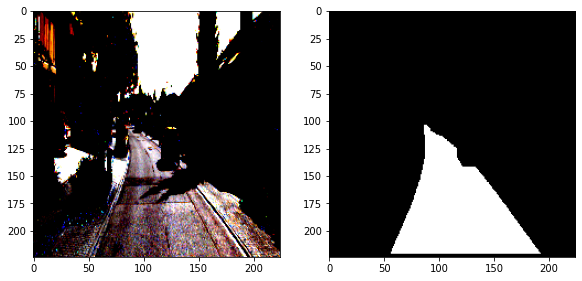

In [ ]:
idx = 5

input_img = img[idx].squeeze().permute(1,2,0).numpy()
mask_ = mask[idx].numpy().reshape(224, 224)

plt.figure(figsize=(15, 15))
plt.subplot(1, 3, 1)
plt.imshow(input_img[..., ::-1])

plt.subplot(1, 3, 2)
plt.imshow(mask_, cmap='gray')

# Modelling

In [ ]:
vgg = models.vgg16(pretrained=False)
sampel = torch.randn(1, 3, 224, 224).float().to(device)
nn.Sequential(*list(vgg.features)[:17]).to(device)(sampel).shape

torch.Size([1, 256, 28, 28])

In [ ]:
class FCN8(nn.Module):
  def __init__(self):
    super(FCN8, self).__init__()
    OUT_CHANNEL = 1 # binary image has 1 channel
    vgg = models.vgg16(pretrained=False)
    self.pool3 = nn.Sequential(*list(vgg.features)[:17])
    self.pool4 = nn.Sequential(*list(vgg.features)[17:24])
    self.pool5 = nn.Sequential(*list(vgg.features)[24:])
    self.conv1 = nn.Conv2d(512, 256, kernel_size=1)
    self.conv2 = nn.Conv2d(256, 256, kernel_size=1)
    self.conv3 = nn.Conv2d(256, OUT_CHANNEL, kernel_size=1)
    self.sigmoid = nn.Sigmoid()
  
  def forward(self, x):
    # forward and take output of each blocks
    # encoder
    x = self.pool3(x)
    c1 = x # [-1, 256, 28, 28]
    x = self.pool4(x)
    c2 = x # [-1, 512, 14, 14]
    c3 = self.pool5(x) # [-1, 512, 7, 7]

    # decoder
    u1 = nn.UpsamplingBilinear2d(scale_factor=2)(c3) # [-1, 512, 14, 14]
    d1 = torch.add(u1, c2) # [-1, 512, 14, 14]
    d1 = self.conv1(d1) # [-1, 256, 14, 14]
    d1 = self.sigmoid(d1)

    u2 = nn.UpsamplingBilinear2d(scale_factor=2)(d1) # [-1, 256, 28, 28]
    d2 = torch.add(u2, c1) # [-1, 256, 28, 28]
    d2 = self.conv2(d2) # # [-1, 256, 28, 28]
    d2 = self.sigmoid(d2)

    # Output
    u3 = nn.UpsamplingBilinear2d(scale_factor=8)(d2) # [-1, 256, 224, 224]
    output = self.conv3(u3) # [-1, 1, 224, 224]
    return output
  
  def predict(self, x, threshold=0.5):
    result = nn.Sigmoid(self.forward(x))
    return (result > threshold).type(torch.uint8)

fcn8 = FCN8().to(device)
summary(model=fcn8, input_size=(1, 3, 224, 224), device=device)

Layer (type:depth-idx)                   Output Shape              Param #
FCN8                                     --                        --
├─Sequential: 1-1                        [1, 256, 28, 28]          --
│    └─Conv2d: 2-1                       [1, 64, 224, 224]         1,792
│    └─ReLU: 2-2                         [1, 64, 224, 224]         --
│    └─Conv2d: 2-3                       [1, 64, 224, 224]         36,928
│    └─ReLU: 2-4                         [1, 64, 224, 224]         --
│    └─MaxPool2d: 2-5                    [1, 64, 112, 112]         --
│    └─Conv2d: 2-6                       [1, 128, 112, 112]        73,856
│    └─ReLU: 2-7                         [1, 128, 112, 112]        --
│    └─Conv2d: 2-8                       [1, 128, 112, 112]        147,584
│    └─ReLU: 2-9                         [1, 128, 112, 112]        --
│    └─MaxPool2d: 2-10                   [1, 128, 56, 56]          --
│    └─Conv2d: 2-11                      [1, 256, 56, 56]          29

## Test output

torch.Size([1, 1, 224, 224])


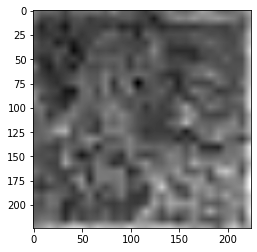

In [ ]:
import subprocess

image_url = 'https://images.all-free-download.com/images/graphiclarge/adorable_animal_breed_canine_cute_dog_doggy_603714.jpg'

subprocess.run(['wget', '-c', image_url, '-O', '/content/test_image.jpg'])

img = cv2.imread("test_image.jpg")
img = cv2.resize(img, (224, 224))
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = torch.tensor(img)
img = img.permute(2, 0, 1)[None]
img = img.to(device).float()

fcn8 = FCN8()
fcn8 = fcn8.to(device)

img_out = fcn8(img)
print(img_out.shape)
imgout = img_out.squeeze().detach().cpu().numpy()
plt.imshow(imgout, cmap='gray')

## Test train step

In [ ]:
# def dice_score(pred, target):
#   pred = (pred > 0).float()
#   dice = 2. * (pred * target).sum(dim=[3,2,1]) / (pred + target).sum(dim=[3,2,1])
#   return dice.detach().cpu().numpy().tolist()

# def _iou(pred, target):
#   '''
#   pred (Tensor):    [num_images, channels, width, height] where channels = 1
#   target (Tensor):  [num_images, channels, width, height] where channels = 1

#   Road mask: pixel 1
#   Background: pixel 0
#   '''
#   intersection = ((pred==target) * (target==1)).sum(dim=[3,2,1])
#   union = (target==1).sum(dim=[3,2,1]) + (pred==1).sum(dim=[3,2,1]) - intersection
#   iou = intersection/union
#   return iou.detach().cpu().numpy().tolist()

# train_data = RoadSegmentDataset(train_data_dir)
# train_dl = DataLoader(train_data, batch_size=12, shuffle=True, drop_last=True)

# val_data = RoadSegmentDataset(train_data_dir=train_data_dir, mode=1)
# val_dl = DataLoader(val_data, batch_size=len(val_data), shuffle=False, drop_last=True)

# criterion = nn.BCEWithLogitsLoss()
# opt = Adam(fcn8.parameters(), lr=0.001)
# ll = []
# acc = []
# for epoch in range(100):
#   for img, mask in iter(train_dl):

#     loss_train = []
#     acc_train = []

#     img, mask = img.to(device), mask.to(device)
#     opt.zero_grad()
#     pred_mask = fcn8(img)
#     loss = criterion(pred_mask, mask)
#     dice = dice_score(pred_mask, mask)
#     # acc_ = (torch.max(pred_mask, 1)[1] == mask).float().mean()
#     loss.backward()
#     opt.step()
#     acc_train.extend(dice)
#     # acc_train.append(acc_.item())
#     loss_train.append(loss.item())
#   ll.append(np.mean(loss_train))
#   acc.append(np.mean(acc_train))

#   print("Epoch: {} | Loss: {} ---- Acc: {}".format(epoch+1, np.mean(loss_train), np.mean(acc_train)))

# Training Model

## Create custom progressbar

In [ ]:
class PBar:
  def __init__(self, size):
    widgets = [' [ ',
         progressbar.Timer(format= 'elapsed time: %(elapsed)s'),
         ' ] Loading: ',
           progressbar.Bar('█'),
           progressbar.Counter(format=' %(value)02d/%(max_value)d'),
           ' (', progressbar.ETA(), ')', ' | ',
           progressbar.widgets.DynamicMessage(name='Loss'), ' , ',
           progressbar.widgets.DynamicMessage(name='Train_Acc'), ' , ',
           progressbar.widgets.DynamicMessage(name='Val_Acc'),
          ]
  
    self.bar = progressbar.ProgressBar(max_value=size, 
                              widgets=widgets).start()

bar = PBar(size=len(range(4)))
for i in range(4):
  time.sleep(0.1)
  bar.bar.dynamic_messages["Loss"]=i*10
  bar.bar.dynamic_messages["Train_Acc"]=i*20
  bar.bar.dynamic_messages["Val_Acc"]=i*30
  bar.bar.update(i+1)        

 [ elapsed time: 0:00:00 ] Loading: || 04/4 (ETA:  00:00:00) | Loss:     30 , Train_Acc:     60 , Val_Acc:     90

## Create Trainer Instance

In [ ]:
class Trainer:
  def __init__(self, model, lr=0.00001):
    self.model = model.to(device)
    self.criterion = nn.BCEWithLogitsLoss()
    self.optimizer = Adam(self.model.parameters(), lr=lr)
    self.train_loss, self.val_loss = [], []
    self.train_acc, self.val_acc = [], []
    self.state_dict = {}
  
  def start(self, dir, epochs=10, batch_size=32, continue_train=False, existed_model_path='',
            save_every_epoch=None, **params):

    train_dl, val_dl = self.load_data(batch_size)
    self.set_checkpoints(epochs=epochs)
    epoch_range = range(0, epochs)
    if continue_train:
      epoch_range = self.load_checkpoints(existed_model_path)

    epochs_bar = PBar(size=len(epoch_range))
    for epoch in epoch_range:
      epoch_train_loss = []
      epoch_val_loss = []
      measure_train = []
      measure_val = []
      
      for idx, (img, mask) in enumerate(iter(train_dl)):
        batch_loss, dice = self.train_batch(img, mask)
        epoch_train_loss.append(batch_loss)
        measure_train.extend(dice)
      train_loss = np.mean(epoch_train_loss)
      train_acc = np.mean(measure_train)
      
      for idx, (img, mask) in enumerate(iter(val_dl)):
        batch_loss, dice = self.val_batch(img, mask)
        measure_val.extend(dice)
        epoch_val_loss.append(batch_loss)
      val_loss = np.mean(epoch_val_loss)
      val_acc = np.mean(measure_val)

      self.train_loss.append(train_loss)
      self.val_loss.append(val_loss)
      self.train_acc.append(train_acc)
      self.val_acc.append(val_acc)

      self.set_checkpoints(start_epoch=epoch,
                           model=self.model.state_dict(),
                           optimizer=self.optimizer.state_dict(),
                           train_loss=self.train_loss,
                           val_loss=self.val_loss,
                           train_acc=self.train_acc,
                           val_acc=self.val_acc)


      self.save_checkpoints(dir=dir, 
                            current_epoch=epoch,
                            final_epoch=epochs, 
                            save_every_epoch=save_every_epoch, 
                            start_at=int(epochs * 0.3),
                            custom_value={"val": val_acc})

      epochs_bar.bar.dynamic_messages["Loss"] = train_loss
      epochs_bar.bar.dynamic_messages["Train_Acc"] = train_acc
      epochs_bar.bar.dynamic_messages["Val_Acc"] = val_acc
      epochs_bar.bar.update(epoch + 1)
  
  def train_batch(self, img, mask):
    self.model.train()
    img, mask = img.to(device), mask.to(device)
    pred_mask = self.model(img)
    batch_loss = self.criterion(pred_mask, mask)
    batch_loss.backward()
    self.optimizer.step()
    self.optimizer.zero_grad()
    dice = self.dice_score(pred_mask, mask)
    return batch_loss.item(), dice
  
  def val_batch(self, img, mask):
    self.model.eval()
    img, mask = img.to(device), mask.to(device)
    with torch.no_grad():
      pred_mask = self.model(img)
    batch_loss = self.criterion(pred_mask, mask)
    dice = self.dice_score(pred_mask, mask)
    return batch_loss.item(), dice
  
  def dice_score(self, pred, target):
    pred = (pred > 0).float()
    dice = 2. * (pred * target).sum(dim=[3,2,1]) / (pred + target).sum(dim=[3,2,1])
    return dice.detach().cpu().numpy().tolist()

  def load_data(self, batch_size):
    train_data = RoadSegmentDataset(train_data_dir)
    train_dl = DataLoader(train_data, batch_size=batch_size, shuffle=True, drop_last=True)

    val_data = RoadSegmentDataset(train_data_dir=train_data_dir, mode=1)
    val_dl = DataLoader(val_data, batch_size=len(val_data), shuffle=False, drop_last=True)

    return train_dl, val_dl
  
  def set_checkpoints(self, **params):
    self.state_dict.update(params)
  
  def save_checkpoints(self, **params):
    dir = params["dir"]
    save_every_epoch = params["save_every_epoch"]
    start_at = params["start_at"]
    current_epoch = params["current_epoch"]
    final_epoch = params["final_epoch"]
    
    assert os.path.exists(dir), '{} not exist'.format(dir)

    default_filename = f'fcn8_model_epoch_{current_epoch}'
    try:
      filename = ''
      custom_value = params["custom_value"]
      assert isinstance(custom_value, dict), """ "custom_value" should be a dictionary """
      name, value = custom_value.keys(), custom_value.values()
      filename = '_'.join([filename, f'{name}_{value:.2f}'])
      
      filename = ''.join([default_filename, filename]) + '.pt'
      path = os.path.join(dir, filename)
    except:
      path = os.path.join(dir, default_filename + '.pt')
    
    if save_every_epoch is not None and current_epoch % save_every_epoch == 0 and current_epoch >= start_at \
                                              and current_epoch != final_epoch - 1:
      torch.save(self.state_dict, path)
    if current_epoch == final_epoch - 1:
      path = os.path.join(dir, 'final_model.pt')
      torch.save(self.state_dict, path)
  
  def load_checkpoints(self, path):
    try:
      self.state_dict = torch.load(path, map_location=torch.device(device))
      self.model.load_state_dict(self.state_dict["model"])
      self.optimizer.load_state_dict(self.state_dict["optimizer"])
      self.train_loss = self.state_dict["train_loss"]
      self.val_loss = self.state_dict["val_loss"]
      self.train_acc = self.state_dict["train_acc"]
      self.val_acc = self.state_dict["val_acc"]
      epochs = self.state_dict["epochs"]
      start_epoch = self.state_dict["start_epoch"]
      return range(start_epoch, epochs)
    except:
      assert """You've provided wrong model path. Please check again at "existed_model_path" parameter """

In [ ]:
# model = FCN8()
# training = Trainer(model)
# training.start(dir='/content', batch_size=12, epochs=200, save_every_epoch=10, 
#                continue_train=True, existed_model_path='/content/fcn8_model_epoch_80_val_0.81.pt')

## Test model

In [ ]:
# state_dict = {
#     "model": model.state_dict(),
#     "optimizer": training.optimizer.state_dict(),
#     "train_loss": training.train_loss,
#     "val_loss": training.val_loss,
#     "train_acc": training.train_acc,
#     "val_acc": training.val_acc
# }
# torch.save(state_dict, './fcn8_model_final.pt')

In [ ]:
# path = '/content/drive/MyDrive/Road_Segmentation/fcn8_model_final.pt'
# state = torch.load(path, map_location=torch.device(device))
# fcn8 = FCN8()
# fcn8.load_state_dict(state["model"])
# fcn8 = fcn8.to(device)

In [ ]:
# def dice_score(pred, target):
#   pred = (pred > 0).float()
#   dice = 2. * (pred * target).sum(dim=[3,2,1]) / (pred + target).sum(dim=[3,2,1])
#   return dice.detach().cpu().numpy().tolist()

# train_data = RoadSegmentDataset(train_data_dir)
# train_dl = DataLoader(train_data, batch_size=12, shuffle=True, drop_last=True)

# val_data = RoadSegmentDataset(train_data_dir=train_data_dir, mode=1)
# val_dl = DataLoader(val_data, batch_size=len(val_data), shuffle=False, drop_last=True)

# img, mask = next(iter(train_dl))
# print(img.shape)
# print(mask.shape)

# idx = 3

# input_img = img[idx].squeeze().permute(1,2,0).numpy()
# mask_ = mask[idx].numpy().reshape(224, 224)

# pred_mask = model(img[idx][None].to(device).float())
# pred_mask_sig = nn.Sigmoid()(pred_mask)
# pred_mask_img = pred_mask_sig.detach().cpu().numpy().reshape(224, 224)
# pred_mask_img = (pred_mask_img > 0.3).astype(np.uint8)

# print(dice_score(pred_mask, mask[idx].to(device)))

# plt.figure(figsize=(15, 15))
# plt.subplot(1, 3, 1)
# plt.imshow(input_img)

# plt.subplot(1, 3, 2)
# plt.imshow(mask_, cmap='gray')

# plt.subplot(1, 3, 3)
# plt.imshow(pred_mask_img, cmap='gray')

In [ ]:
# !cp /content/fcn8_model_final.pt /content/drive/MyDrive/Road_Segmentation

# Training Model using Pytorch-Lightning

## Build model

In [ ]:
from itertools import chain

class FCN8_Model(LightningModule):
  def __init__(self, train_mode=False, metrics=None, batch_size=24, dataset_path=None):
    super(FCN8_Model, self).__init__()
    self.example_input_array = torch.randn((1, 3, 224, 224))

    try:
      self.test = RoadSegmentDataset(train_data_dir=dataset_path, mode=2, aug=False)
      self.test_dl = DataLoader(self.test, batch_size=len(self.test), shuffle=False, 
                                drop_last=True, collate_fn=self.test.collate_fn)
    except:
      assert "Invalid dataset path"
    
    if train_mode:
      assert dataset_path is None or os.path.exists(dataset_path), 'Invalid dataset path!'
      self.data_dir = dataset_path
      
    self.batch_size = batch_size
    self.criterion = nn.BCEWithLogitsLoss()
    self.build_model()
    self.metrics = metrics
    if self.metrics is None:
      self.metrics = self.dice_score
    
  
  def forward(self, x):
    # forward and take output of each blocks
    # encoder
    x = self.pool3(x)
    c1 = x # [-1, 256, 28, 28]
    x = self.pool4(x)
    c2 = x # [-1, 512, 14, 14]
    c3 = self.pool5(x) # [-1, 512, 7, 7]

    # decoder
    u1 = nn.UpsamplingBilinear2d(scale_factor=2)(c3) # [-1, 512, 14, 14]
    d1 = torch.add(u1, c2) # [-1, 512, 14, 14]
    d1 = self.conv1(d1) # [-1, 256, 14, 14]
    d1 = self.sigmoid(d1)

    u2 = nn.UpsamplingBilinear2d(scale_factor=2)(d1) # [-1, 256, 28, 28]
    d2 = torch.add(u2, c1) # [-1, 256, 28, 28]
    d2 = self.conv2(d2) # # [-1, 256, 28, 28]
    d2 = self.sigmoid(d2)

    # Output
    u3 = nn.UpsamplingBilinear2d(scale_factor=8)(d2) # [-1, 256, 224, 224]
    output = self.conv3(u3) # [-1, 1, 224, 224]
    return output

  def training_step(self, batch, batch_idx):
    img, mask = batch
    pred_mask = self(img)
    batch_loss = self.criterion(pred_mask, mask)
    dice = self.metrics(pred_mask, mask)
    return {'loss': batch_loss, 'dice': dice}

  def training_epoch_end(self, outputs):
    if self.current_epoch == 1:
      # Computational graph Tensorboard
      self.logger.experiment.add_graph(FCN8_Model(), self.example_input_array)

    # Logging Histogram
    self.custom_histogram_adder()

    loss = torch.stack([x['loss'] for x in outputs]).mean()
    dice = list(chain.from_iterable([x['dice'] for x in outputs]))
    dice_avg = np.mean(dice)
    # tensorboard_train_logs = {'train_loss': loss, 'train_dice': dice_avg}
    self.log("train_loss", loss, on_step=False, on_epoch=True, prog_bar=True)
    self.log("train_dice", dice_avg, on_step=False, on_epoch=True, prog_bar=True)
    self.logger.experiment.add_scalar("Loss/Train", loss, self.current_epoch)
    self.logger.experiment.add_scalar("Score/Train", dice_avg, self.current_epoch)
    # self.log("logs", tensorboard_train_logs, on_step=False, on_epoch=True, prog_bar=True)

  def validation_step(self, batch, batch_idx):
    img, mask = batch
    pred_mask = self(img)
    batch_loss = self.criterion(pred_mask, mask)
    dice = self.metrics(pred_mask, mask)
    idx = np.random.randint(0, len(img))
    ref_img, ref_mask = self.create_ref_image(img, mask, idx)
    return {'loss': batch_loss, 'dice': dice, 'ref_img': ref_img, 'ref_mask': ref_mask}
  
  def validation_epoch_end(self, outputs):
    loss = torch.stack([x['loss'] for x in outputs]).mean()
    dice = list(chain.from_iterable([x['dice'] for x in outputs]))
    dice_avg = np.mean(dice)
    # tensorboard_train_logs = {'val_loss': loss, 'val_dice': dice_avg}
    self.log("val_loss", loss, on_step=False, on_epoch=True, prog_bar=True)
    self.log("val_dice", dice_avg, on_step=False, on_epoch=True, prog_bar=True)
    # self.log("logs", tensorboard_train_logs, on_step=False, on_epoch=True, prog_bar=True)
    self.logger.experiment.add_scalar("Loss/Val", loss, self.current_epoch)
    self.logger.experiment.add_scalar("Score/Val", dice_avg, self.current_epoch)

    ref_img, ref_mask = outputs[-1]["ref_img"], outputs[-1]["ref_mask"]
    pred_mask_ = self.predict(ref_img)

    self.logger.experiment.add_image("Input_Norm", ref_img, 
                                     self.current_epoch, dataformats="HWC")
    self.logger.experiment.add_image("Mask_GT", ref_mask,
                                     self.current_epoch, dataformats="HW")
    self.logger.experiment.add_image("Mask_Pred", pred_mask_, 
                                     self.current_epoch, dataformats="HW")

  def custom_image_adder(self, img):
    self.logger.experiment.add_scaler()

  def custom_histogram_adder(self):
    for name, params in self.named_parameters():
      self.logger.experiment.add_histogram(name, params, self.current_epoch)

  def train_dataloader(self):
    train = RoadSegmentDataset(train_data_dir=self.data_dir, mode=0, aug=True)
    train_dl = DataLoader(train, batch_size=int(self.batch_size / 2), shuffle=True, drop_last=True, collate_fn=train.collate_fn)
    return train_dl

  def val_dataloader(self):
    val = RoadSegmentDataset(train_data_dir=self.data_dir, mode=1, aug=False)
    val_dl = DataLoader(val, batch_size=len(val), shuffle=False, drop_last=True, collate_fn=val.collate_fn)
    return val_dl

  def configure_optimizers(self):
    optimizer = torch.optim.Adam(self.parameters(), lr=1e-3)
    return optimizer

  def dice_score(self, pred, target):
    pred = (pred > 0).float()
    dice = 2. * (pred * target).sum(dim=[3,2,1]) / (pred + target).sum(dim=[3,2,1])
    return dice.detach().cpu().numpy().tolist()

  def build_model(self):
    OUT_CHANNEL = 1 # binary image has 1 channel
    vgg = models.vgg16(pretrained=False)
    self.pool3 = nn.Sequential(*list(vgg.features)[:17])
    self.pool4 = nn.Sequential(*list(vgg.features)[17:24])
    self.pool5 = nn.Sequential(*list(vgg.features)[24:])
    self.conv1 = nn.Conv2d(512, 256, kernel_size=1)
    self.conv2 = nn.Conv2d(256, 256, kernel_size=1)
    self.conv3 = nn.Conv2d(256, OUT_CHANNEL, kernel_size=1)
    self.sigmoid = nn.Sigmoid()

  def predict(self, x, confidence=0.3):
    assert isinstance(x, np.ndarray) or hasattr(x, 'shape'), 'Input x supposed to be a numpy array'
    assert len(x.shape) == 3 and x.shape[-1] == 3, 'Input image x has to be an RGB image'
    # Convert image np.array to torch.tensor and apply normalize
    normalize = transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
    x = cv2.resize(x, (224, 224))
    x = torch.tensor(x).float() / 255.0
    x = x.permute(2, 0, 1)
    x = normalize(x)[None]
    x = x.to(self.device)
    mask = nn.Sigmoid()(self(x)).detach().cpu().numpy().reshape(224, 224)
    mask = (mask > confidence).astype(np.uint8)
    return mask

  def create_ref_image(self, imgs, masks, idx):
    img = imgs[idx].permute(2,1,0).detach().cpu().numpy()

    mask = masks[idx][0].detach().cpu().numpy()
    
    return img, mask


In [ ]:
#!rm -r /content/lightning_logs

## Train model

In [ ]:
path = '/content/drive/MyDrive/Road_Segmentation/checkpoints'

val_acc = ModelCheckpoint(
    monitor='val_dice',
    dirpath=path,
    filename='fcn8_pl-{epoch:03d}-{val_dice:.2f}',
    save_top_k=3,
    mode='max',
    every_n_epochs=10,
)

model = FCN8_Model(train_mode=True, dataset_path=train_data_dir)
trainer = Trainer(max_epochs=120, gpus=1, callbacks=[val_acc],
                  log_every_n_steps=16)
                  #default_root_dir='/content/drive/MyDrive/Road_Segmentation/logs')
trainer.fit(model)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Missing logger folder: /content/lightning_logs

  | Name      | Type              | Params | In sizes           | Out sizes       
----------------------------------------------------------------------------------------
0 | criterion | BCEWithLogitsLoss | 0      | ?                  | ?               
1 | pool3     | Sequential        | 1.7 M  | [1, 3, 224, 224]   | [1, 256, 28, 28]
2 | pool4     | Sequential        | 5.9 M  | [1, 256, 28, 28]   | [1, 512, 14, 14]
3 | pool5     | Sequential        | 7.1 M  | [1, 512, 14, 14]   | [1, 512, 7, 7]  
4 | conv1     | Conv2d            | 131 K  | [1, 512, 14, 14]   | [1, 256, 14, 14]
5 | conv2     | Conv2d            | 65.8 K | [1, 256, 28, 28]   | [1, 256, 28, 28]
6 | conv3     | Conv2d            | 257    | [1, 256, 224, 224] | [1, 1, 224, 224]
7 | sigmoid   | Sigmoid           | 0      | [1,

Validation sanity check: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/_jit_internal.py:668: LightningDeprecationWarning: The `LightningModule.loaded_optimizer_states_dict` property is deprecated in v1.4 and will be removed in v1.6.
  if hasattr(mod, name):
/usr/local/lib/python3.7/dist-packages/torch/_jit_internal.py:668: LightningDeprecationWarning: The `LightningModule.model_size` property was deprecated in v1.5 and will be removed in v1.7. Please use the `pytorch_lightning.utilities.memory.get_model_size_mb`.
  if hasattr(mod, name):
/usr/local/lib/python3.7/dist-packages/torch/_jit_internal.py:669: LightningDeprecationWarning: The `LightningModule.model_size` property was deprecated in v1.5 and will be removed in v1.7. Please use the `pytorch_lightning.utilities.memory.get_model_size_mb`.
  item = getattr(mod, name)


Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

## Continue Train

In [ ]:
# trainer.fit(model, ckpt_path='/content/drive/MyDrive/Road_Segmentation/checkpoints/last.ckpt')

## Visualize training and validating process

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Road_Segmentation/lightning_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Test model

In [ ]:
model = FCN8_Model(train_mode=False).load_from_checkpoint(
    '/content/drive/MyDrive/Road_Segmentation/checkpoints/last.ckpt',
    map_location='cpu'
)

In [ ]:
res = trainer.validate(dataloaders=model.test_dl)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1399: UserWarning: `.validate(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `validate(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.checkpoint_callback.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at /content/drive/MyDrive/Road_Segmentation/checkpoints/fcn8_pl-epoch=099-val_dice=0.94.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/drive/MyDrive/Road_Segmentation/checkpoints/fcn8_pl-epoch=099-val_dice=0.94.ckpt


Validating: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 VALIDATE RESULTS
{'val_dice': 0.9330770650080272, 'val_loss': 0.060876838862895966}
--------------------------------------------------------------------------------


In [ ]:
res

[{'val_dice': 0.9330770650080272, 'val_loss': 0.060876838862895966}]

In [ ]:
test_ = RoadSegmentDataset(train_data_dir=train_data_dir, mode=2)
test_dl = DataLoader(test_, batch_size=len(test_), shuffle=False, drop_last=True, collate_fn=test_.collate_fn)

img, mask = next(iter(test_dl))
img.shape, mask.shape

(torch.Size([28, 3, 224, 224]), torch.Size([28, 1, 224, 224]))

### Visualize some results

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


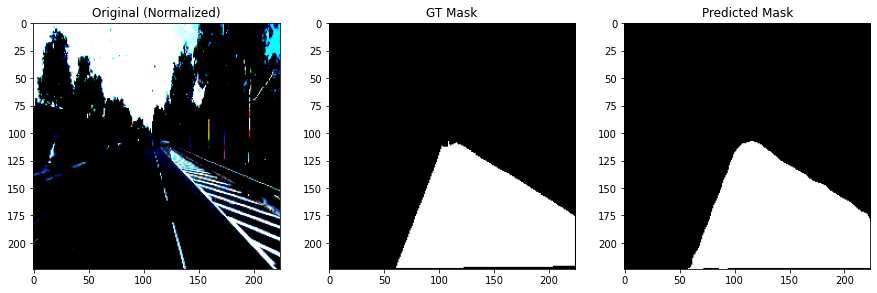

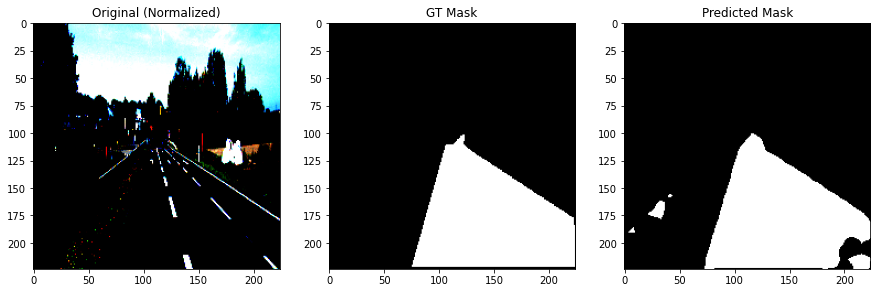

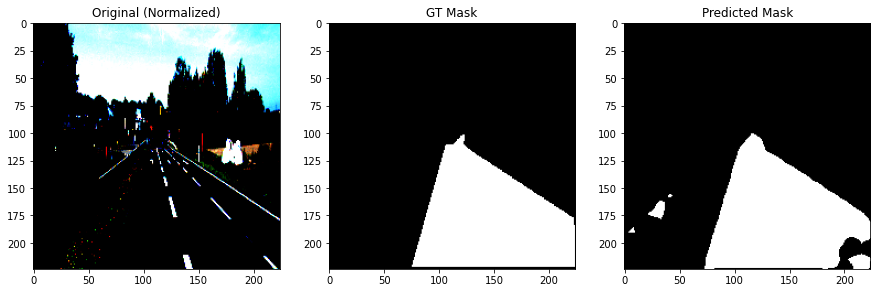

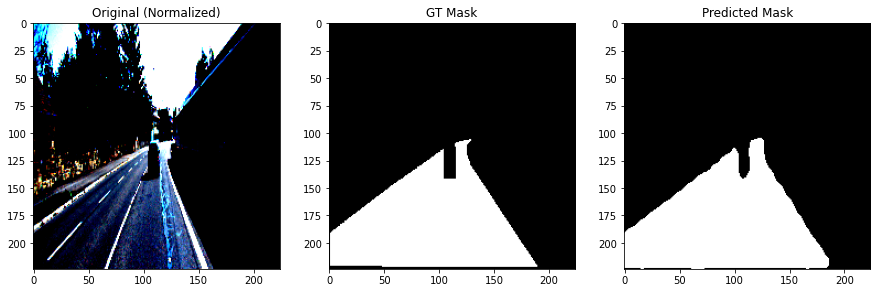

In [ ]:
test_model = FCN8_Model.load_from_checkpoint('/content/drive/MyDrive/Road_Segmentation/checkpoints/fcn8_pl-epoch=099-val_dice=0.94.ckpt')
test_model = test_model.to(device)

for i in range(4):
  idx = np.random.randint(0, len(test_))

  input_img = img[idx].squeeze().permute(1,2,0).numpy()
  mask_ = mask[idx].numpy().reshape(224, 224)

  pred_mask = test_model(img[idx][None].to(device).float())
  pred_mask_sig = nn.Sigmoid()(pred_mask)
  pred_mask_img = pred_mask_sig.detach().cpu().numpy().reshape(224, 224)
  pred_mask_img = (pred_mask_img > 0.3).astype(np.uint8)

  plt.figure(figsize=(15, 15))
  plt.subplot(1, 3, 1)
  plt.title('Original (Normalized)')
  plt.imshow(input_img)

  plt.subplot(1, 3, 2)
  plt.title('GT Mask')
  plt.imshow(mask_, cmap='gray')

  plt.subplot(1, 3, 3)
  plt.title('Predicted Mask')
  plt.imshow(pred_mask_img, cmap='gray')

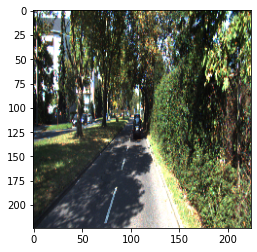

In [ ]:
path_img = '/content/kittiroadsegmentation/training/image_2/um_000008.png'
og_img = cv2.imread(path_img)
rgb = og_img[..., ::-1]
rgb = cv2.resize(rgb, (224, 224))
plt.imshow(rgb)

In [ ]:
normalize = transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )

input = torch.tensor(rgb).float() / 255.0
input = input.permute(2, 0, 1)
input = normalize(input)[None]

pred_mask = test_model(input.to(device))
pred_mask_sig = nn.Sigmoid()(pred_mask)
pred_mask_img = pred_mask_sig.detach().cpu().numpy().reshape(224, 224)
pred_mask_img = (pred_mask_img > 0.3).astype(np.uint8)
pred_mask_img.shape

(224, 224)

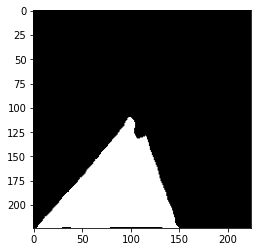

In [ ]:
plt.imshow(pred_mask_img, cmap='gray')

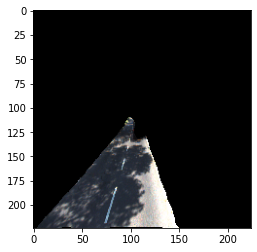

In [ ]:
masked = cv2.bitwise_and(rgb, rgb, mask=pred_mask_img)
plt.imshow(masked)

In [ ]:
pred_mask_img1 = cv2.normalize(pred_mask_img, None, alpha = 0, beta = 255, norm_type = cv2.NORM_MINMAX)
pred_mask_img1 = pred_mask_img1[..., None]
pred_mask_img1.shape

(224, 224, 1)

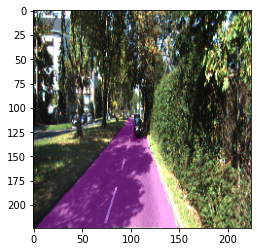

In [ ]:
output_img = rgb[..., ::-1].copy()
output_img[(pred_mask_img1 == 255).all(-1)] = [255, 0, 255]

out = cv2.addWeighted(output_img, 0.3, rgb[..., ::-1], 0.7, 0, output_img)
plt.imshow(out[..., ::-1])

In [ ]:
def predict_frame(frame, model):
  rgb = frame[..., ::-1]
  rgb = cv2.resize(rgb, (224, 224))

  normalize = transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )

  input = torch.tensor(rgb).float() / 255.0
  input = input.permute(2, 0, 1)
  input = normalize(input)[None]

  pred_mask = model(input.to(device))
  pred_mask_sig = nn.Sigmoid()(pred_mask)
  pred_mask_img = pred_mask_sig.detach().cpu().numpy().reshape(224, 224)
  pred_mask_img = (pred_mask_img > 0.3).astype(np.uint8)

  pred_mask_img1 = cv2.normalize(pred_mask_img, None, alpha = 0, beta = 255, norm_type = cv2.NORM_MINMAX)
  pred_mask_img1 = pred_mask_img1[..., None]

  output_img = rgb[..., ::-1].copy()
  output_img[(pred_mask_img1 == 255).all(-1)] = [255, 0, 255]

  out = cv2.addWeighted(output_img, 0.3, rgb[..., ::-1], 0.7, 0, output_img)
  return out

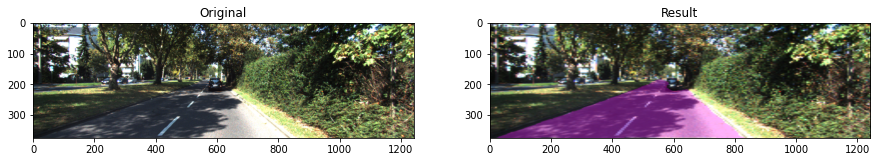

In [ ]:
test_model = FCN8_Model.load_from_checkpoint('/content/drive/MyDrive/Road_Segmentation/checkpoints/fcn8_pl-epoch=099-val_dice=0.94.ckpt')
test_model = test_model.to(device)

path_img = '/content/kittiroadsegmentation/training/image_2/um_000008.png'
og_img = cv2.imread(path_img)
h, w = og_img.shape[:2]
out = predict_frame(og_img, test_model)

plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.title('Original')
plt.imshow(og_img[..., ::-1])

plt.subplot(1, 2, 2)
plt.title('Result')
plt.imshow(cv2.resize(out, (w, h))[..., ::-1])

# Test

In [ ]:
video_path = '/content/kittiroadsegmentation/testing/project_video.mp4'

In [ ]:
from moviepy.editor import *

clip=VideoFileClip(video_path)
clip.ipython_display(width=720)

100%|█████████▉| 1260/1261 [00:18<00:00, 66.86it/s]


In [ ]:
test_model = FCN8_Model.load_from_checkpoint('/content/drive/MyDrive/Road_Segmentation/checkpoints/fcn8_pl-epoch=099-val_dice=0.94.ckpt')
test_model = test_model.to(device)

cap = cv2.VideoCapture(video_path)

w, h = (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)))
fps = cap.get(cv2.CAP_PROP_FPS)
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
videoWriter = cv2.VideoWriter("res.mp4", fourcc, fps, (w, h))

while True:
  ret, frame = cap.read()
  if not ret: break
  out = predict_frame(frame, test_model)
  res = cv2.resize(out, (w, h))
  res = res[..., ::-1]
  videoWriter.write(res)
cap.release()

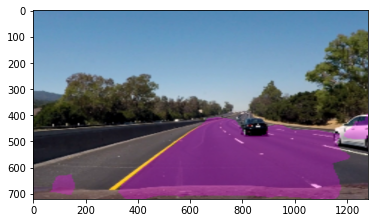

In [ ]:
plt.imshow(res)

In [ ]:
from moviepy.editor import *

clip=VideoFileClip('/content/res.mp4')
clip.ipython_display(width=720)

100%|█████████▉| 250/251 [00:03<00:00, 75.92it/s]
